# Importing libraries

In [44]:
import os
gpu_num = 0 # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

# Colab does currently not support the latest version of ipython.
# Thus, the preview does not work in Colab. However, whenever possible we
# strongly recommend to use the scene preview mode.
try: # detect if the notebook runs in Colab
    import google.colab
    colab_compat = True # deactivate preview
except:
    colab_compat = False
resolution = [480,320] # increase for higher quality of renderings

# Allows to exit cell execution in Jupyter
class ExitCell(Exception):
    def _render_traceback_(self):
        pass

# Import Sionna
try:
    import sionna as sn
except ImportError as e:
    # Install Sionna if package is not already installed
    import os
    os.system("pip install sionna")
    import sionna as sn

# Configure the notebook to use only a single GPU and allocate only as much memory as needed
# For more details, see https://www.tensorflow.org/guide/gpu
import tensorflow as tf
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)
# Avoid warnings from TensorFlow
tf.get_logger().setLevel('ERROR')

tf.random.set_seed(1) # Set global random seed for reproducibility

In [45]:
# Import Sionna RT components
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray, RadioMaterial, LambertianPattern

In [46]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import math

# Loading and setting scene properties

Loading scene

In [47]:
scene = load_scene("blender/scene.xml")

In [48]:
NLoS = True

if NLoS == True:
    obstacle = scene.get("Metal_box2") 
    #obstacle.position = [3.5, 2.9, 0.9] # Simulation
    obstacle.position = [5, 2.5, 0.9] # NLoS
    obstacle2 = scene.get("Desoldering_station2")
    #obstacle2.position = [3.5, 2.9, 1.2] # Simulation
    obstacle2.position = [5, 2.5, 1.2] # NLoS

Creating custom materials

In [49]:
polycarbonate = RadioMaterial("polycarbonate",
                              relative_permittivity=3,
                              conductivity=0.001,
                              scattering_coefficient=0.3,
                              xpd_coefficient=0.1,
                              scattering_pattern=LambertianPattern())

cardboard  = RadioMaterial("cardboard",
                           relative_permittivity=2.3,
                           conductivity=0.001,
                           scattering_coefficient=0.3,
                           xpd_coefficient=0.1,
                           scattering_pattern=LambertianPattern())

plastic = RadioMaterial("plastic",
                        relative_permittivity=2.8,
                        conductivity=0.0001,
                        scattering_coefficient=0.3,
                        xpd_coefficient=0.1,
                        scattering_pattern=LambertianPattern())

ceramic  = RadioMaterial("ceramic",
                         relative_permittivity=6,
                         conductivity=0.0001,
                         scattering_coefficient=0.3,
                         xpd_coefficient=0.1,
                         scattering_pattern=LambertianPattern())

Selecting scene parts made from custom materials

In [50]:
Polycarbonate_parts = scene.get("Polycarbonate_parts")
Paper_boxes = scene.get("Paper_boxes") 
Plastic_parts = scene.get("Plastic_parts")  
Ceramic_parts = scene.get("Ceramic_parts")

Assigning custom materials to the scene

In [51]:
Polycarbonate_parts.radio_material = polycarbonate 
Paper_boxes.radio_material = cardboard 
Plastic_parts.radio_material = plastic 
Ceramic_parts.radio_material = ceramic

Setting scene parameters

In [52]:
scene.frequency = 60.48e9 # in Hz; implicitly updates RadioMaterials
scene.bandwidth = 512e6
scene.synthetic_array = True # If set to False, ray tracing will be done per antenna element (slower for large arrays)

# Configuration of TX and RX antenna

In [53]:
# Configure antenna array for all transmitters
scene.tx_array = PlanarArray(num_rows=1, #16
                             num_cols=1, #4
                             vertical_spacing=0.1,
                             horizontal_spacing=0.1,
                             pattern="iso",
                             polarization="H")

# Configure antenna array for all receivers
scene.rx_array = PlanarArray(num_rows=1, #16
                             num_cols=1, #16
                             vertical_spacing=0.1,
                             horizontal_spacing=0.1,
                             pattern="iso",
                             polarization="H")

# Create transmitter
tx = Transmitter(name="tx",
                 color=tf.Variable((1, 0, 0), dtype=tf.float32),
                 #position=tf.Variable([0.5,3,1], dtype=tf.float32), # Simulation
                 position=tf.Variable([2.5,4.5,1], dtype=tf.float32), # LoS
                 #position=tf.Variable([6.1,2.5,1], dtype=tf.float32), # NLoS
                 orientation=tf.Variable([0,0,0], dtype=tf.float32))

# Add transmitter instance to scene
scene.add(tx)

# Create a receiver
rx = Receiver(name="rx",
              color=tf.Variable((1, 0, 0), dtype=tf.float32),
              #position=tf.Variable([6.4,3,1], dtype=tf.float32), # Simulation
              position=tf.Variable([4.2,3.2,1], dtype=tf.float32), # LoS
              #position=tf.Variable([4.2,2.5,1], dtype=tf.float32), # NLoS
              orientation=tf.Variable([0,0,0], dtype=tf.float32))

# Add receiver instance to scene
scene.add(rx)

tx.look_at(rx) # Transmitter points towards receiver
rx.look_at(tx) # Receiver points towards transmitter 

# Compute propagation paths

In [54]:
paths = scene.compute_paths(max_depth=2,
                            num_samples=1e6)  # Number of rays shot into directions defined
                                              # by a Fibonacci sphere , too few rays can
                                              # lead to missing paths

# Paths parameters

Path types

In [55]:
# Show the types of all paths:
# 0 - LoS, 1 - Reflected, 2 - Diffracted, 3 - Scattered
# Note that Diffraction and scattering are turned off by default.
print("Path types: ", paths.types.numpy())

Path types:  [[0 1 1 1 1 1 1 1 1 1 1 1 1]]


Shapes of passband channel coeficients and delay

In [56]:
paths.normalize_delays = False
a, tau = paths.cir()
print("Shape of a: ", a.shape)
print("Shape of tau: ", tau.shape)

Shape of a:  (1, 1, 1, 1, 1, 13, 1)
Shape of tau:  (1, 1, 1, 13)


Number of paths

In [57]:
all_paths = tau.shape[3]
print(all_paths)

13


# Saving CIR into impulse_response.dat

In [58]:
def angles(path_idx, angle_idx):
    if impulse_response[path_idx][angle_idx] < 0:
        impulse_response[path_idx][angle_idx] = 360 + impulse_response[path_idx][angle_idx]
        
    if impulse_response[path_idx][angle_idx] == 360:
        impulse_response[path_idx][angle_idx] = 0

In [59]:
# Initialize the matrix with zeros
impulse_response = np.zeros((all_paths, 7))

unit = 1 # 0 = rad, 1 = degree 

for path_idx in range(all_paths):
    impulse_response[path_idx][0] = path_idx                                              # Path index
    impulse_response[path_idx][1] = np.abs(paths.a[0,0,0,0,0,path_idx, 0].numpy())        # Channel coefficient
    impulse_response[path_idx][2] = paths.tau[0,0,0,path_idx].numpy()                     # Propagation delay [s]

    if unit == 0:
        impulse_response[path_idx][3] = paths.theta_t[0,0,0,path_idx].numpy()             # Zenith angle of departure [rad]
        impulse_response[path_idx][4] = paths.phi_t[0,0,0,path_idx].numpy()               # Azimuth angle of departure [rad]
        impulse_response[path_idx][5] = paths.theta_r[0,0,0,path_idx].numpy()             # Zenith angle of arrival [rad]
        impulse_response[path_idx][6] = paths.phi_r[0,0,0,path_idx].numpy()               # Azimuth angle of arrival [rad]
        
    elif unit == 1:
        impulse_response[path_idx][3] = round(paths.theta_t[0,0,0,path_idx].numpy()*180/math.pi) # Zenith angle of departure [°]
        impulse_response[path_idx][4] = round(paths.phi_t[0,0,0,path_idx].numpy()*180/math.pi)   # Azimuth angle of departure [°]
        impulse_response[path_idx][5] = round(paths.theta_r[0,0,0,path_idx].numpy()*180/math.pi) # Zenith angle of arrival [°]
        impulse_response[path_idx][6] = round(paths.phi_r[0,0,0,path_idx].numpy()*180/math.pi)   # Azimuth angle of arrival [°]

    angles(path_idx, 3)
    angles(path_idx, 4)
    angles(path_idx, 5)
    angles(path_idx, 6)

In [60]:
#np.save('data/impulse_response.npy', impulse_response)
#np.save('data/impulse_response_NLoS.npy', impulse_response)
#np.save('data/LoS_simulation.npy', impulse_response)
#np.save('data/NLoS_simulation.npy', impulse_response)

# CIR plots

CIR for delay

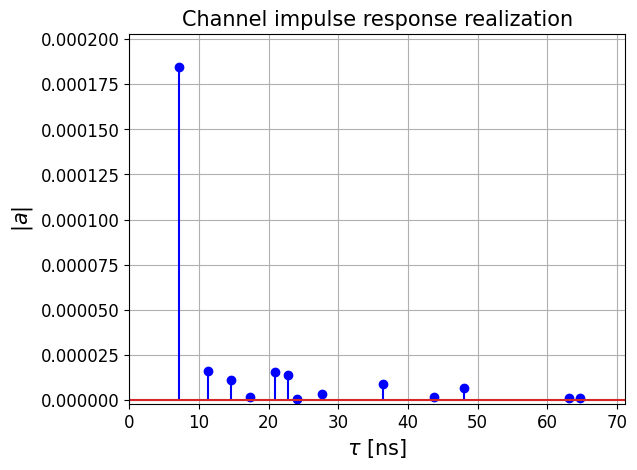

In [61]:
t = tau[0,0,0,:]/1e-9 # Scale to ns
a_abs = np.abs(a)[0,0,0,0,0,:,0]
a_max = np.max(a_abs)
# Add dummy entry at start/end for nicer figure
t = np.concatenate([(0.,), t, (np.max(t)*1.1,)])
a_abs = np.concatenate([(np.nan,), a_abs, (np.nan,)])

# And plot the CIR
plt.figure()
plt.title("Channel impulse response realization", fontsize=15)
plt.stem(t, a_abs,'b')
plt.xlim([0, np.max(t)])
plt.ylim([-2e-6, a_max*1.1])
plt.xlabel(r"$\tau$ [ns]", fontsize=15)
plt.ylabel(r"$|a|$", fontsize=15);
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(True)
plt.show()

CIR for angle of departure

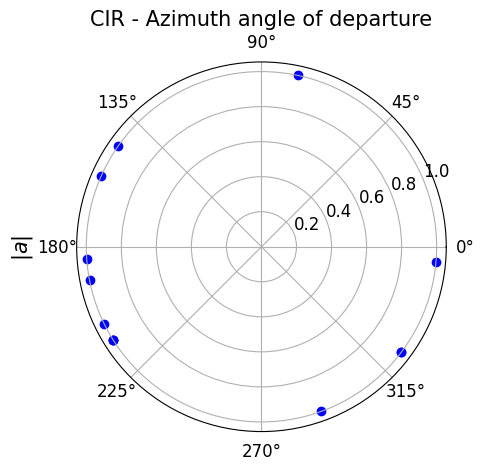

In [62]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.scatter(impulse_response[:,4]*np.pi/180, np.ones((all_paths, 1)),color='blue')
ax.set_title("CIR - Azimuth angle of departure", fontsize=15)
ax.set_ylabel(r"$|a|$", labelpad=30, fontsize=15)
ax.tick_params(axis='y',labelsize=12)
ax.tick_params(axis='x',labelsize=12)
ax.grid(True)
plt.show()

CIR for angle of arrival

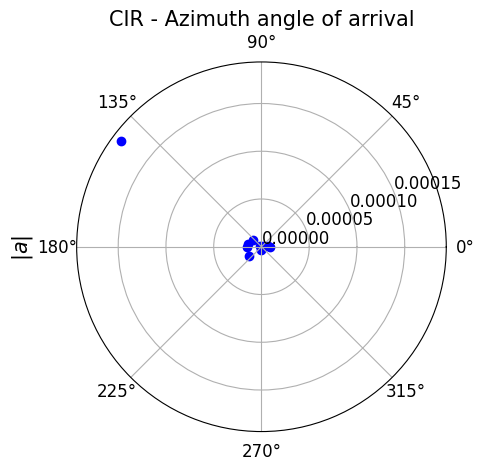

In [63]:
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
ax.scatter(impulse_response[:,6]*np.pi/180, impulse_response[:,1],color='blue')
ax.yaxis.set_major_locator(MaxNLocator(nbins=4))
ax.set_title("CIR - Azimuth angle of arrival", fontsize=15)
ax.set_ylabel(r"$|a|$", labelpad=30, fontsize=15)
ax.tick_params(axis='y',labelsize=12)
ax.tick_params(axis='x',labelsize=12)
ax.grid(True)
plt.show()

# Ray tracing scene preview

In [65]:
def switch(show):
    if show == "scene":
        return scene.preview(fov=90, clip_at=2.89)
    elif show == "pathsz":
        return scene.preview(paths, show_devices=True, show_paths=True, fov=90, clip_at=2.89)
    elif show == "pathsy":
        return scene.preview(paths, show_devices=True, show_paths=True, fov=90, clip_at=-0.65,clip_plane_orientation=(0, 1, 0))
    elif show == "pathsx":
        return scene.preview(paths, show_devices=True, show_paths=True, fov=90, clip_at=-0.8,clip_plane_orientation=(1, 0, 0))

switch("pathsz")

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…